In [1]:
ROOT_DIR = "/home/user/Documents/projects/Metaworld"

import sys
sys.path.append(ROOT_DIR)

%matplotlib widget  
import argparse
import gc
import os
import json
import random
from PIL import Image

import cv2
import numpy as np

import gc
import matplotlib.pyplot as plt
import torch
from torchvision.transforms import PILToTensor
import torch.nn as nn
import numpy as np
import torch.nn.functional as F
from scipy.spatial.transform import Rotation as R
import importlib
from typing import List
from easydict import EasyDict as edict
from tqdm import tqdm

# visualization
import plotly.express as px
import plotly.graph_objects as go
from lightglue import viz2d

In [2]:
# custom imports
# from src.models.dift_sd import SDFeaturizer
# from src.utils.visualization import Demo
from keyframes.align_ft_spair.utils import ft_align_utils, geo_utils, spair_utils, pca_colormap
from keyframes.align_ft_spair.ext import utils_dataset, utils_correspondence


# Setup Paths

In [3]:
```
python run.py \
    --checkpoint prs-eth/marigold-v1-0 \
    --denoise_steps 50 \
    --ensemble_size 10 \
    --input_rgb_dir /media/user/ssd2t/datasets2/SPair-71k/JPEGImages/aeroplane \
    --output_dir /media/user/EXTREMESSD/datasets/SPair-71k/miragold/aeroplane
```

SyntaxError: invalid syntax (1383992365.py, line 1)

In [4]:
spair_data_folder = '/media/user/ssd2t/datasets2/SPair-71k'
spair_img_folder = f'{spair_data_folder}/JPEGImages'
category_folder_names = os.listdir(spair_img_folder)
category_folder_names_to_category_name = {
    'pottedplant': 'potted plant',
    'tvmonitor': 'tv-monitor',
    'aeroplane': 'airplane'
}
# NOTE segany embeddings are not so suitable
# segany_embds_folder = '/media/user/EXTREMESSD/datasets/SPair-71k/SegAnyFeatures'
# segany_embd_size = 64
sd48_embds_folder = f'/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures'
sd48_embd_size = 48  # 48
sd48_img_size = 768

sd60_embds_folder = f'/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60'
sd60_embd_size = 60  # 48
sd60_img_size = 960

geo_embds_folder = '/media/user/EXTREMESSD/datasets/SPair-71k/geo'
geo_embd_size = 60
geo_img_size = 960

embds_folder = geo_embds_folder
embd_size = geo_embd_size
img_size = geo_img_size  # 768
PAD = True
print(embds_folder, img_size, embd_size, PAD)

/media/user/EXTREMESSD/datasets/SPair-71k/geo 960 60 True


# Data

In [5]:
aeroplane_cat_idx = 0

## Train Data

In [6]:
aeroplane_train_files_unique_np = np.load(f'/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_train_files_unique.npy')
aeroplane_train_files_unique = aeroplane_train_files_unique_np.tolist()

## Evaluation Data

In [7]:
# we still need eval_files
# NOTE there are 53'340 train, 5'384 validation, and 12'234 test pair annotations
# NOTE the dataset contains only 1800 images
# kpts[2*pair_idx] matches to kpts[2*pair_idx+1] and files[2*pair_idx] matches to files[2*pair_idx+1] etc.

args = edict({
    "BBOX_THRE": True,
    "TRAIN_DATASET": None,
    "EVAL_DATASET": None,
    "DATA_ROOT_DIR": "/media/user/ssd2t/datasets2",
    "ANNO_SIZE": img_size,
    "TEST_SAMPLE": None
})
eval_category = "aeroplane"
eval_files, eval_kpts, eval_thresholds, eval_used_kpts = utils_dataset.load_eval_data(args, spair_data_folder, eval_category, "test")
print(len(eval_files), eval_kpts.shape, len(eval_thresholds), len(eval_used_kpts))

# NOTE eval_files already are only those files belonging to a certain category (here aeroplane)
aeroplane_eval_files_unique = list(set(eval_files))

1380 torch.Size([1380, 25, 3]) 690 25


In [8]:
aeroplane_eval_files_unique_np = np.load(f'/home/user/Documents/projects/diffusion-features/experiments/ft_align/aeroplane_eval_files_unique.npy')
aeroplane_eval_files_unique = aeroplane_eval_files_unique_np.tolist()

## Load Embeddings

In [9]:
importlib.reload(geo_utils)

<module 'keyframes.align_ft_spair.utils.geo_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/geo_utils.py'>

In [10]:
from keyframes.align_ft_spair.ext import projection_network
aggre_net = projection_network.AggregationNetwork(feature_dims=[640,1280,1280,768], projection_dim=768, device='cuda')
aggre_net.load_pretrained_weights(torch.load('/home/user/Documents/projects/GeoAware-SC/results_spair/best_856.PTH'))

AggregationNetwork has 5150214 parameters.


In [22]:
def get_geo_embd(img_file, flip=False):
    return geo_utils.get_geo_embd(
        img_file,
        embds_folder_dino=geo_embds_folder,
        embds_folder_sd=sd60_embds_folder,
        flip=flip,
    )

# def get_geo_embd(img_file, flip=False):
#     return geo_utils.get_geo_embd_aggregated(
#         img_file,
#         embds_folder_geo=geo_embds_folder,
#         aggre_net=aggre_net,
#         flip=flip,
#     )

In [24]:
# dino embeddings (much better)

# load eval embeddings
aeroplane_eval_img_embds = []
for img_file in aeroplane_eval_files_unique:
    aeroplane_eval_img_embds.append(get_geo_embd(img_file, flip=False))
aeroplane_eval_img_embds = torch.cat(aeroplane_eval_img_embds, dim=0)

# load train embeddings
aeroplane_train_img_embds = []
for img_file in aeroplane_train_files_unique:
    aeroplane_train_img_embds.append(get_geo_embd(img_file, flip=False))

# concat with flipped img embeddings
for img_file in aeroplane_train_files_unique:
    aeroplane_train_img_embds.append(get_geo_embd(img_file, flip=True))
aeroplane_train_img_embds = torch.cat(aeroplane_train_img_embds, dim=0)

aeroplane_train_img_embds_hat = F.normalize(aeroplane_train_img_embds)
aeroplane_eval_img_embds_hat = F.normalize(aeroplane_eval_img_embds)

print(aeroplane_eval_img_embds.shape, aeroplane_train_img_embds.shape)

torch.Size([27, 2048, 60, 60]) torch.Size([110, 2048, 60, 60])


# Evaluation

## Existing Approach

In [25]:
def sim_fun_cos_sim(query_embd, trg_img_embd):
    """
    Args:
        query_embd: (1, C)
        trg_img_embd: (1, C, embd_size, embd_size)
    """
    return F.cosine_similarity(query_embd[:,:,None,None], trg_img_embd, dim=1)[0]

In [14]:
# RES48 with pad: {0.1: 0.6190476190476191, 0.05: 0.47637222828062525, 0.01: 0.05652490003635042}
# RES60 with pad: {0.1: 0.6306797528171574, 0.05: 0.5232642675390767, 0.01: 0.1079607415485278}
alpha_statistics, pair_statistics = spair_utils.evaluate_spair(
    img_files=eval_files,
    sim_fun=sim_fun_cos_sim,
    spair_data_folder=spair_data_folder,
    # embds_folder=embds_folder,
    embds_loader=get_geo_embd,
    img_size=img_size,
    embd_size=embd_size,
    pad=PAD,
)
print(alpha_statistics)

100%|██████████| 690/690 [00:19<00:00, 34.69it/s]

{0.1: 0.9127589967284624, 0.05: 0.8645946928389676, 0.01: 0.27880770628862234}


In [15]:
PAD

True

In [ ]:
alpha_statistics

## New Approach

In [13]:
# TODO create reverse attention
# for each kpt_embd compute attention with target
# for each pixel take maximum over attentions

In [26]:
def compute_attn(query: torch.Tensor, test: torch.Tensor):
    """ Compute attention between query and test tensors.
    Args:
        kpt_embds: tensor of shape (n or 1, C)
        test_embd: tensor of shape (n or 1, C, h, w)
    Returns:
        attn: tensor of shape (n, h, w)
    """
    _, _, h, w = test.shape
    query = F.normalize(query, dim=1)
    test = F.normalize(test, dim=1)
    attn = query[:,:,None,None] * test  # (n_samples, C, h, w)
    attn = torch.sum(attn, dim=1)
    attn = attn.view(-1, h*w)
    attn = F.softmax(attn, dim=1)
    attn = attn.view(-1, h, w)
    return attn

def find_kpt_index(query_embd, train_embds, kpt_embd_coords, enable_left_right_check=True):
    """
    Args:
        query_embd: tensor of shape (1, C)
        train_embds: tensor of shape (n_samples, C, h, w)
        kpt_embd_coords: list containing n_samples tensors of shape (n_kpts, 3) where the 3rd dim is the kpt index
    """
    attn = compute_attn(query_embd, train_embds)  # (n_samples, h, w)

    # extract attns at keypoint coords
    n_kpts, n_samples = 30, len(kpt_embd_coords)
    all_kpt_attn = torch.zeros((n_samples, n_kpts))
    for i in range(n_samples):
        if kpt_embd_coords[0].size(0) > 0: 
            x_coords = kpt_embd_coords[i][:,0]
            y_coords = kpt_embd_coords[i][:,1]
            kpt_indices = kpt_embd_coords[i][:,2]
            kpt_attns = attn[i,y_coords,x_coords]
            all_kpt_attn[i,kpt_indices] = kpt_attns.cpu()
    best_sample_kpt_attn = torch.max(all_kpt_attn, dim=0).values
    kpt_index_tensor = torch.argmax(best_sample_kpt_attn)
    kpt_index = kpt_index_tensor.item()

    
    # if kpt_index has left/right issue, 
    # only consider images where both instances are present
    sample_selection = []
    if enable_left_right_check and kpt_index >= 4 and kpt_index <= 21:
        kpt_index_1 = kpt_index - (kpt_index % 2)
        kpt_index_2 = kpt_index_1 + 1
        for i in range(n_samples):
            if kpt_embd_coords[0].size(0) > 0:
                kpt_indices = kpt_embd_coords[i][:,2].tolist()
                if kpt_index_1 in kpt_indices and kpt_index_2 in kpt_indices:
                    sample_selection.append(i)

        # for each sample, find kpt index with maximum likelihood
        
        # best_kpts_per_sample = torch.argmax(all_kpt_attn[sample_selection], dim=1)
        # TODO only use top20 best guesses
        
        # NOTE this works because each image is flipped => distribution is fair
        # count occurences
        # kpt_max_count = torch.zeros((n_kpts,))
        # for best_kpt in best_kpts_per_sample.tolist():
        #     if best_kpt == kpt_index_1 or best_kpt == kpt_index_2:
        #         kpt_max_count[best_kpt] += 1
        # # print(kpt_max_count[kpt_index_1], kpt_max_count[kpt_index_2])
        # kpt_index_tensor = torch.argmax(kpt_max_count)

        best_sample_kpt_attn = torch.max(all_kpt_attn[sample_selection], dim=0).values
        kpt_index_tensor = torch.argmax(best_sample_kpt_attn)
    return kpt_index_tensor #, all_kpt_attn, sample_selection, best_sample_kpt_attn


def compute_max_attn(kpt_embds: torch.Tensor, test_embd: torch.Tensor):
    """ Compute maximmum attention over n samples.
    Args:
        kpt_embds: tensor of shape (n, C)
        test_embd: tensor of shape (1, C, h, w)
    """
    attn = compute_attn(kpt_embds, test_embd)
    max_attn = torch.max(attn, dim=0).values
    return max_attn

In [27]:
importlib.reload(spair_utils)

<module 'keyframes.align_ft_spair.utils.spair_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/spair_utils.py'>

In [28]:
aeroplane_train_img_kpt_embd_coords = spair_utils.load_kpt_embd_coords(
    img_files=aeroplane_train_files_unique,
    spair_data_folder=spair_data_folder,
    img_new_size=img_size, 
    embd_size=embd_size, 
    angle_deg=0, 
    pad=PAD
)
n_train_imgs = len(aeroplane_train_img_kpt_embd_coords)

# load with flip=1
aeroplane_train_img_kpt_embd_coords_flipped = spair_utils.load_kpt_embd_coords(
    img_files=aeroplane_train_files_unique,
    spair_data_folder=spair_data_folder,
    img_new_size=img_size, 
    embd_size=embd_size, 
    angle_deg=0,
    flip=1,
    pad=PAD,
    get_flipped_kpt_index=spair_utils.aeroplane_get_flipped_kpt_index,
)
# concat keypoints
aeroplane_train_img_kpt_embd_coords += aeroplane_train_img_kpt_embd_coords_flipped
for i in range(n_train_imgs):
    if aeroplane_train_img_kpt_embd_coords[i].shape[0] != aeroplane_train_img_kpt_embd_coords[i+n_train_imgs].shape[0]:
        print(i, aeroplane_train_img_kpt_embd_coords[i].shape)

In [29]:
# TODO assemble kpt embeddings
# extract features at kpt embedding coords
max_n_kpts = 30
kpt_idx_to_kpt_embds = {i: [] for i in range(max_n_kpts)}
for i in range(len(aeroplane_train_img_kpt_embd_coords)):
    embd_coords = aeroplane_train_img_kpt_embd_coords[i]
    if (embd_coords.size(0) > 0):
        kpt_embds = aeroplane_train_img_embds_hat[i, :, embd_coords[:,1], embd_coords[:,0]]  # shape (C, n_kpts)
        for j, kpt_idx in enumerate(embd_coords[:,2].tolist()):
            kpt_idx_to_kpt_embds[kpt_idx].append(kpt_embds[:, j])
for i in range(max_n_kpts):
    if len(kpt_idx_to_kpt_embds[i]) > 0:
        kpt_idx_to_kpt_embds[i] = torch.stack(kpt_idx_to_kpt_embds[i])
    else:
        kpt_idx_to_kpt_embds[i] = None

In [30]:
# tranfer aeroplane_train_img_embds_hat and kpt_idx_to_kpt_embds to cuda device
aeroplane_train_img_embds_hat = aeroplane_train_img_embds_hat.to("cuda")
for i in range(max_n_kpts):
    if kpt_idx_to_kpt_embds[i] is not None:
        kpt_idx_to_kpt_embds[i] = kpt_idx_to_kpt_embds[i].to("cuda")

In [31]:
def sim_fun_3(query_embd, trg_img_embd):
    """
    Args:
        query_embd: (1, C)
        trg_img_embd: (1, C, embd_size, embd_size)
    """
    kpt_index = find_kpt_index(query_embd.to("cuda"), aeroplane_train_img_embds_hat, aeroplane_train_img_kpt_embd_coords, enable_left_right_check=False).item()
    sim = compute_max_attn(
        kpt_embds=kpt_idx_to_kpt_embds[kpt_index], 
        test_embd=trg_img_embd.to("cuda")
    )
    return sim.cpu()

In [32]:
PAD

True

In [40]:
importlib.reload(spair_utils)

<module 'keyframes.align_ft_spair.utils.spair_utils' from '/home/user/Documents/projects/Metaworld/keyframes/align_ft_spair/utils/spair_utils.py'>

In [41]:
# DINO: {0.1: 0.7988004362050164, 0.05: 0.7119229371137769, 0.01: 0.19520174482006544}
# DINO+SD at 60: {0.1: 0.8335150854234824, 0.05: 0.771901126862959, 0.01: 0.2515448927662668}
# DINO+SD + allow_left_right=True: {0.1: 0.9191203198836787, 0.05: 0.8562340966921119, 0.01: 0.27535441657579063}
#   ==> we only need left/right check to work 
alpha_statistics_3, pair_statistics_3 = spair_utils.evaluate_spair(
    img_files=eval_files,
    sim_fun=sim_fun_3,
    spair_data_folder=spair_data_folder,
    embds_loader=get_geo_embd,
    img_size=img_size,
    embd_size=embd_size,
    pad=PAD,
    allow_left_right=True,
    left_right_pairs=[4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21]
)
alpha_statistics_3

  0%|          | 1/690 [00:00<01:35,  7.20it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  0%|          | 2/690 [00:00<03:25,  3.36it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


  0%|          | 3/690 [00:01<04:41,  2.44it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 14 15


  1%|          | 4/690 [00:01<04:52,  2.35it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  1%|          | 5/690 [00:01<04:10,  2.73it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 13 12


  1%|          | 6/690 [00:02<03:36,  3.16it/s]

other kpt_index does not exist 16 17


  1%|          | 7/690 [00:02<03:40,  3.09it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 7 6
other kpt_index does not exist 15 14


  1%|          | 8/690 [00:02<04:25,  2.57it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20
other kpt_index does not exist 9 8
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


  1%|▏         | 9/690 [00:03<04:40,  2.43it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  2%|▏         | 11/690 [00:03<03:49,  2.96it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


  2%|▏         | 12/690 [00:04<04:30,  2.51it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


  2%|▏         | 13/690 [00:04<04:42,  2.40it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  2%|▏         | 14/690 [00:05<04:24,  2.55it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


  2%|▏         | 15/690 [00:05<04:53,  2.30it/s]

other kpt_index does not exist 20 21


  2%|▏         | 16/690 [00:06<04:16,  2.63it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  2%|▏         | 17/690 [00:06<05:02,  2.22it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


  3%|▎         | 19/690 [00:07<04:27,  2.51it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 13 12


  3%|▎         | 20/690 [00:08<05:23,  2.07it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


  3%|▎         | 21/690 [00:08<05:40,  1.96it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 12 13
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  3%|▎         | 23/690 [00:09<06:13,  1.79it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  3%|▎         | 24/690 [00:10<05:13,  2.12it/s]

other kpt_index does not exist 12 13
other kpt_index does not exist 15 14


  4%|▍         | 30/690 [00:11<02:13,  4.93it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


  5%|▍         | 34/690 [00:11<01:44,  6.28it/s]

other kpt_index does not exist 7 6


  6%|▌         | 38/690 [00:12<01:59,  5.44it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


  6%|▌         | 43/690 [00:13<02:08,  5.02it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


  7%|▋         | 45/690 [00:13<01:58,  5.42it/s]

other kpt_index does not exist 11 10


  7%|▋         | 51/690 [00:15<02:20,  4.55it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 11 10


  8%|▊         | 53/690 [00:15<02:07,  5.01it/s]

other kpt_index does not exist 10 11
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  8%|▊         | 56/690 [00:15<01:59,  5.29it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 16 17


  8%|▊         | 57/690 [00:16<02:03,  5.14it/s]

other kpt_index does not exist 18 19


  9%|▊         | 59/690 [00:16<02:28,  4.26it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  9%|▊         | 60/690 [00:17<02:38,  3.97it/s]

other kpt_index does not exist 11 10


  9%|▉         | 62/690 [00:17<02:37,  3.98it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


  9%|▉         | 64/690 [00:18<02:58,  3.51it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 10%|▉         | 66/690 [00:18<03:12,  3.25it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16


 10%|▉         | 67/690 [00:19<02:39,  3.90it/s]

other kpt_index does not exist 11 10


 10%|▉         | 68/690 [00:19<03:05,  3.35it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 10%|█         | 69/690 [00:19<03:31,  2.94it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 10%|█         | 71/690 [00:20<03:46,  2.73it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 11%|█         | 75/690 [00:21<03:10,  3.22it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 11%|█         | 77/690 [00:22<03:18,  3.09it/s]

other kpt_index does not exist 8 9


 11%|█▏        | 78/690 [00:22<03:07,  3.27it/s]

other kpt_index does not exist 8 9


 11%|█▏        | 79/690 [00:22<03:04,  3.31it/s]

other kpt_index does not exist 16 17


 12%|█▏        | 80/690 [00:23<03:18,  3.07it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 7 6
other kpt_index does not exist 15 14


 12%|█▏        | 81/690 [00:24<04:14,  2.40it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 12%|█▏        | 82/690 [00:24<04:34,  2.22it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 12%|█▏        | 83/690 [00:25<04:44,  2.14it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 12%|█▏        | 84/690 [00:25<03:52,  2.61it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 12%|█▏        | 85/690 [00:25<04:54,  2.05it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 12%|█▏        | 86/690 [00:26<05:03,  1.99it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 13%|█▎        | 87/690 [00:26<04:11,  2.40it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 13%|█▎        | 88/690 [00:27<04:33,  2.20it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 13%|█▎        | 90/690 [00:28<04:34,  2.18it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 13%|█▎        | 92/690 [00:29<04:41,  2.12it/s]

other kpt_index does not exist 11 10


 14%|█▍        | 97/690 [00:31<04:27,  2.22it/s]

other kpt_index does not exist 15 14


 14%|█▍        | 99/690 [00:32<03:50,  2.57it/s]

other kpt_index does not exist 5 4


 15%|█▍        | 101/690 [00:32<03:12,  3.06it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 15%|█▌        | 104/690 [00:33<03:10,  3.07it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 15%|█▌        | 105/690 [00:34<03:06,  3.13it/s]

other kpt_index does not exist 16 17


 15%|█▌        | 106/690 [00:34<03:17,  2.96it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 16%|█▌        | 108/690 [00:35<03:17,  2.94it/s]

other kpt_index does not exist 17 16
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 16%|█▌        | 110/690 [00:35<03:08,  3.07it/s]

other kpt_index does not exist 6 7


 16%|█▌        | 112/690 [00:36<03:11,  3.02it/s]

other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11


 16%|█▋        | 113/690 [00:36<03:18,  2.90it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 17%|█▋        | 115/690 [00:37<03:07,  3.06it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 17%|█▋        | 117/690 [00:38<03:26,  2.77it/s]

other kpt_index does not exist 17 16


 17%|█▋        | 119/690 [00:39<03:28,  2.74it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 17%|█▋        | 120/690 [00:39<03:56,  2.41it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19


 18%|█▊        | 121/690 [00:39<03:54,  2.43it/s]

other kpt_index does not exist 20 21


 18%|█▊        | 122/690 [00:40<04:12,  2.25it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 19%|█▉        | 130/690 [00:42<02:01,  4.61it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 19%|█▉        | 132/690 [00:42<02:04,  4.48it/s]

other kpt_index does not exist 8 9


 19%|█▉        | 134/690 [00:43<02:11,  4.23it/s]

other kpt_index does not exist 13 12


 20%|█▉        | 135/690 [00:43<02:21,  3.91it/s]

other kpt_index does not exist 8 9


 20%|█▉        | 136/690 [00:43<02:15,  4.08it/s]

other kpt_index does not exist 6 7


 20%|██        | 139/690 [00:44<02:00,  4.59it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 20%|██        | 140/690 [00:44<02:13,  4.13it/s]

other kpt_index does not exist 8 9


 21%|██        | 143/690 [00:45<02:19,  3.92it/s]

other kpt_index does not exist 13 12


 21%|██        | 144/690 [00:45<02:28,  3.69it/s]

other kpt_index does not exist 13 12


 21%|██        | 146/690 [00:46<02:19,  3.89it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 6 7


 22%|██▏       | 154/690 [00:47<01:39,  5.39it/s]

other kpt_index does not exist 18 19


 22%|██▏       | 155/690 [00:48<01:57,  4.55it/s]

other kpt_index does not exist 19 18


 23%|██▎       | 156/690 [00:48<02:10,  4.09it/s]

other kpt_index does not exist 18 19


 23%|██▎       | 158/690 [00:48<02:13,  4.00it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 23%|██▎       | 159/690 [00:49<02:07,  4.17it/s]

other kpt_index does not exist 19 18


 23%|██▎       | 160/690 [00:49<02:10,  4.05it/s]

other kpt_index does not exist 19 18


 23%|██▎       | 161/690 [00:49<02:19,  3.80it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 24%|██▎       | 163/690 [00:50<02:11,  4.01it/s]

other kpt_index does not exist 19 18


 24%|██▍       | 164/690 [00:50<02:06,  4.15it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 24%|██▍       | 166/690 [00:50<02:08,  4.08it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 24%|██▍       | 168/690 [00:51<01:58,  4.40it/s]

other kpt_index does not exist 18 19


 24%|██▍       | 169/690 [00:51<02:03,  4.22it/s]

other kpt_index does not exist 19 18


 25%|██▍       | 171/690 [00:51<01:52,  4.63it/s]

other kpt_index does not exist 18 19


 25%|██▍       | 172/690 [00:52<01:58,  4.37it/s]

other kpt_index does not exist 18 19


 25%|██▌       | 173/690 [00:52<01:50,  4.70it/s]

other kpt_index does not exist 18 19


 25%|██▌       | 174/690 [00:52<01:57,  4.41it/s]

other kpt_index does not exist 18 19


 26%|██▌       | 180/690 [00:53<01:45,  4.83it/s]

other kpt_index does not exist 18 19


 26%|██▋       | 182/690 [00:54<02:29,  3.39it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 18 19


 27%|██▋       | 183/690 [00:54<02:24,  3.50it/s]

other kpt_index does not exist 8 9


 27%|██▋       | 184/690 [00:55<02:26,  3.45it/s]

other kpt_index does not exist 16 17


 27%|██▋       | 187/690 [00:56<02:44,  3.06it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 28%|██▊       | 191/690 [00:57<02:18,  3.61it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 28%|██▊       | 194/690 [00:58<02:39,  3.11it/s]

other kpt_index does not exist 18 19


 29%|██▊       | 197/690 [00:59<02:32,  3.22it/s]

other kpt_index does not exist 18 19


 29%|██▊       | 198/690 [00:59<02:43,  3.02it/s]

other kpt_index does not exist 18 19


 29%|██▉       | 199/690 [00:59<02:37,  3.13it/s]

other kpt_index does not exist 12 13
other kpt_index does not exist 18 19


 29%|██▉       | 200/690 [01:00<02:50,  2.87it/s]

other kpt_index does not exist 18 19


 29%|██▉       | 201/690 [01:00<02:43,  2.98it/s]

other kpt_index does not exist 12 13


 30%|██▉       | 205/690 [01:01<02:18,  3.51it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 30%|██▉       | 206/690 [01:01<02:24,  3.35it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 30%|███       | 207/690 [01:02<03:13,  2.49it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11


 30%|███       | 209/690 [01:03<02:34,  3.12it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 31%|███       | 211/690 [01:03<02:19,  3.43it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 31%|███       | 213/690 [01:04<03:01,  2.62it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 31%|███       | 215/690 [01:05<02:58,  2.66it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20
other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 31%|███▏      | 217/690 [01:05<02:52,  2.74it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 32%|███▏      | 220/690 [01:07<03:08,  2.50it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 32%|███▏      | 222/690 [01:08<03:07,  2.49it/s]

other kpt_index does not exist 11 10


 33%|███▎      | 227/690 [01:10<03:06,  2.49it/s]

other kpt_index does not exist 15 14


 33%|███▎      | 229/690 [01:10<02:36,  2.94it/s]

other kpt_index does not exist 5 4


 33%|███▎      | 231/690 [01:11<02:30,  3.05it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 34%|███▎      | 232/690 [01:11<02:19,  3.27it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18


 34%|███▍      | 234/690 [01:12<02:47,  2.72it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 10 11


 34%|███▍      | 235/690 [01:12<02:38,  2.86it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 13 12


 34%|███▍      | 237/690 [01:13<02:19,  3.26it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 19 18


 35%|███▍      | 239/690 [01:14<02:57,  2.54it/s]

other kpt_index does not exist 10 11


 35%|███▍      | 240/690 [01:14<02:34,  2.91it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18


 35%|███▌      | 242/690 [01:15<03:24,  2.19it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 35%|███▌      | 243/690 [01:15<02:46,  2.68it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 10 11


 36%|███▌      | 246/690 [01:17<03:14,  2.28it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 36%|███▌      | 248/690 [01:18<03:32,  2.08it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 13 12


 36%|███▌      | 249/690 [01:18<03:32,  2.08it/s]

other kpt_index does not exist 6 7


 36%|███▋      | 251/690 [01:19<02:49,  2.59it/s]

other kpt_index does not exist 6 7


 37%|███▋      | 255/690 [01:20<02:27,  2.95it/s]

other kpt_index does not exist 5 4


 37%|███▋      | 257/690 [01:21<02:15,  3.19it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 38%|███▊      | 259/690 [01:22<02:36,  2.76it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 38%|███▊      | 261/690 [01:23<02:39,  2.70it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 38%|███▊      | 262/690 [01:23<02:29,  2.86it/s]

other kpt_index does not exist 16 17


 38%|███▊      | 263/690 [01:23<02:37,  2.71it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 7 6


 39%|███▊      | 266/690 [01:25<02:30,  2.81it/s]

other kpt_index does not exist 6 7


 39%|███▊      | 267/690 [01:25<02:48,  2.51it/s]

other kpt_index does not exist 7 6


 39%|███▉      | 268/690 [01:25<02:50,  2.48it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 39%|███▉      | 269/690 [01:26<02:44,  2.55it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 39%|███▉      | 272/690 [01:27<03:21,  2.08it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 40%|███▉      | 273/690 [01:28<03:12,  2.16it/s]

other kpt_index does not exist 7 6


 40%|███▉      | 275/690 [01:29<03:15,  2.12it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 40%|████      | 276/690 [01:29<03:17,  2.10it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 40%|████      | 278/690 [01:30<03:19,  2.07it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 41%|████      | 282/690 [01:31<02:02,  3.34it/s]

other kpt_index does not exist 5 4


 41%|████▏     | 285/690 [01:32<01:26,  4.66it/s]

other kpt_index does not exist 6 7


 42%|████▏     | 287/690 [01:32<01:17,  5.17it/s]

other kpt_index does not exist 6 7


 42%|████▏     | 293/690 [01:33<01:16,  5.16it/s]

other kpt_index does not exist 6 7


 44%|████▎     | 301/690 [01:35<01:08,  5.64it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 6 7


 45%|████▍     | 308/690 [01:36<01:28,  4.31it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 45%|████▍     | 309/690 [01:36<01:34,  4.02it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 45%|████▍     | 310/690 [01:37<02:22,  2.66it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 45%|████▌     | 311/690 [01:38<02:22,  2.66it/s]

other kpt_index does not exist 8 9


 45%|████▌     | 312/690 [01:38<02:09,  2.91it/s]

other kpt_index does not exist 8 9


 45%|████▌     | 313/690 [01:38<02:04,  3.02it/s]

other kpt_index does not exist 16 17


 46%|████▌     | 314/690 [01:38<02:09,  2.90it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 7 6
other kpt_index does not exist 15 14


 46%|████▌     | 315/690 [01:39<02:41,  2.32it/s]

other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 46%|████▌     | 316/690 [01:40<02:52,  2.17it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 46%|████▌     | 317/690 [01:40<02:55,  2.12it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 46%|████▌     | 319/690 [01:41<02:38,  2.34it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 46%|████▋     | 320/690 [01:41<02:14,  2.75it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 47%|████▋     | 321/690 [01:42<02:32,  2.42it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 47%|████▋     | 323/690 [01:42<02:40,  2.29it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 47%|████▋     | 325/690 [01:43<02:48,  2.17it/s]

other kpt_index does not exist 11 10


 48%|████▊     | 330/690 [01:46<02:41,  2.23it/s]

other kpt_index does not exist 15 14


 48%|████▊     | 332/690 [01:46<02:18,  2.59it/s]

other kpt_index does not exist 5 4


 48%|████▊     | 334/690 [01:47<02:05,  2.85it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 49%|████▊     | 335/690 [01:47<01:50,  3.22it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 49%|████▉     | 337/690 [01:48<02:06,  2.80it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 10 11


 49%|████▉     | 338/690 [01:48<01:56,  3.02it/s]

other kpt_index does not exist 6 7


 49%|████▉     | 340/690 [01:49<01:36,  3.61it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 19 18


 49%|████▉     | 341/690 [01:49<01:59,  2.91it/s]

other kpt_index does not exist 21 20


 50%|████▉     | 342/690 [01:50<02:23,  2.43it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 50%|████▉     | 343/690 [01:50<02:23,  2.42it/s]

other kpt_index does not exist 10 11


 50%|████▉     | 344/690 [01:51<02:02,  2.82it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 50%|█████     | 346/690 [01:51<01:51,  3.08it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 10 11


 51%|█████     | 350/690 [01:53<02:23,  2.36it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 51%|█████     | 351/690 [01:53<02:22,  2.38it/s]

other kpt_index does not exist 11 10


 51%|█████     | 353/690 [01:54<02:16,  2.48it/s]

other kpt_index does not exist 6 7


 51%|█████▏    | 354/690 [01:54<01:56,  2.88it/s]

other kpt_index does not exist 6 7


 52%|█████▏    | 358/690 [01:56<01:47,  3.10it/s]

other kpt_index does not exist 5 4


 52%|█████▏    | 360/690 [01:56<01:42,  3.23it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 52%|█████▏    | 361/690 [01:57<01:31,  3.59it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 53%|█████▎    | 363/690 [01:57<01:22,  3.96it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 53%|█████▎    | 365/690 [01:58<01:15,  4.30it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 53%|█████▎    | 367/690 [01:58<01:09,  4.62it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 53%|█████▎    | 368/690 [01:58<01:23,  3.87it/s]

other kpt_index does not exist 6 7


 54%|█████▍    | 371/690 [01:59<00:58,  5.43it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 54%|█████▍    | 374/690 [01:59<01:09,  4.55it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 55%|█████▍    | 377/690 [02:00<01:08,  4.55it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7


 55%|█████▍    | 378/690 [02:00<01:20,  3.86it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 55%|█████▌    | 380/690 [02:01<01:31,  3.41it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 56%|█████▌    | 384/690 [02:02<01:30,  3.38it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 56%|█████▌    | 385/690 [02:03<01:33,  3.28it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 56%|█████▌    | 386/690 [02:03<01:53,  2.68it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 56%|█████▌    | 388/690 [02:04<01:53,  2.67it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 56%|█████▋    | 389/690 [02:04<01:45,  2.85it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 57%|█████▋    | 390/690 [02:05<01:54,  2.63it/s]

other kpt_index does not exist 7 6


 57%|█████▋    | 392/690 [02:06<02:09,  2.30it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 57%|█████▋    | 394/690 [02:06<02:02,  2.42it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 57%|█████▋    | 396/690 [02:07<02:11,  2.23it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 58%|█████▊    | 399/690 [02:09<02:18,  2.10it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 58%|█████▊    | 400/690 [02:09<02:15,  2.13it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 58%|█████▊    | 401/690 [02:10<02:13,  2.16it/s]

other kpt_index does not exist 11 10


 58%|█████▊    | 402/690 [02:10<02:24,  1.99it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 18 19


 58%|█████▊    | 403/690 [02:11<02:27,  1.94it/s]

other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 12 13
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 59%|█████▊    | 405/690 [02:12<02:32,  1.86it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 59%|█████▉    | 406/690 [02:12<02:25,  1.95it/s]

other kpt_index does not exist 12 13


 59%|█████▉    | 408/690 [02:13<01:51,  2.53it/s]

other kpt_index does not exist 5 4


 59%|█████▉    | 410/690 [02:13<01:24,  3.32it/s]

other kpt_index does not exist 7 6


 60%|█████▉    | 412/690 [02:14<01:12,  3.81it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 6 7


 60%|██████    | 414/690 [02:14<01:02,  4.45it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 13 12


 60%|██████    | 415/690 [02:14<01:01,  4.50it/s]

other kpt_index does not exist 12 13


 60%|██████    | 416/690 [02:15<00:59,  4.57it/s]

other kpt_index does not exist 7 6


 60%|██████    | 417/690 [02:15<01:12,  3.76it/s]

other kpt_index does not exist 13 12


 61%|██████    | 419/690 [02:16<01:11,  3.76it/s]

other kpt_index does not exist 6 7


 61%|██████    | 420/690 [02:16<01:14,  3.65it/s]

other kpt_index does not exist 7 6


 61%|██████    | 421/690 [02:16<01:18,  3.43it/s]

other kpt_index does not exist 6 7


 61%|██████▏   | 423/690 [02:17<01:08,  3.93it/s]

other kpt_index does not exist 12 13


 62%|██████▏   | 425/690 [02:17<01:14,  3.54it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 13 12


 62%|██████▏   | 426/690 [02:18<01:21,  3.25it/s]

other kpt_index does not exist 13 12


 62%|██████▏   | 429/690 [02:18<01:01,  4.28it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 6 7
other kpt_index does not exist 12 13


 63%|██████▎   | 432/690 [02:19<01:04,  3.98it/s]

other kpt_index does not exist 12 13


 63%|██████▎   | 433/690 [02:19<01:01,  4.15it/s]

other kpt_index does not exist 5 4


 63%|██████▎   | 435/690 [02:20<01:15,  3.40it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 63%|██████▎   | 436/690 [02:21<01:25,  2.98it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 63%|██████▎   | 437/690 [02:21<01:41,  2.48it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 14 15


 63%|██████▎   | 438/690 [02:22<01:50,  2.28it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 64%|██████▎   | 439/690 [02:22<01:36,  2.60it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 64%|██████▍   | 440/690 [02:22<01:26,  2.88it/s]

other kpt_index does not exist 16 17


 64%|██████▍   | 441/690 [02:23<01:28,  2.81it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 7 6


 64%|██████▍   | 443/690 [02:24<01:49,  2.25it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 64%|██████▍   | 445/690 [02:24<01:37,  2.50it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 65%|██████▍   | 447/690 [02:25<01:52,  2.16it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 65%|██████▍   | 448/690 [02:26<01:44,  2.31it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 65%|██████▌   | 450/690 [02:27<01:44,  2.29it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16


 66%|██████▌   | 452/690 [02:28<01:45,  2.26it/s]

other kpt_index does not exist 11 10


 66%|██████▌   | 453/690 [02:28<02:01,  1.95it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 66%|██████▌   | 454/690 [02:29<02:07,  1.86it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 66%|██████▌   | 455/690 [02:29<01:56,  2.01it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 66%|██████▌   | 456/690 [02:30<02:14,  1.74it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 67%|██████▋   | 459/690 [02:31<01:32,  2.51it/s]

other kpt_index does not exist 5 4


 67%|██████▋   | 461/690 [02:32<01:19,  2.88it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8


 67%|██████▋   | 462/690 [02:32<01:12,  3.14it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18


 67%|██████▋   | 465/690 [02:33<01:14,  3.00it/s]

other kpt_index does not exist 13 12


 68%|██████▊   | 467/690 [02:34<01:08,  3.25it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 19 18


 68%|██████▊   | 468/690 [02:34<01:20,  2.77it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 68%|██████▊   | 471/690 [02:35<01:16,  2.87it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 19 18


 69%|██████▊   | 473/690 [02:36<01:35,  2.28it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 69%|██████▉   | 478/690 [02:38<01:28,  2.39it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 13 12


 70%|███████   | 485/690 [02:41<01:07,  3.04it/s]

other kpt_index does not exist 5 4


 71%|███████   | 488/690 [02:41<00:49,  4.11it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 71%|███████   | 489/690 [02:42<00:59,  3.40it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 71%|███████   | 490/690 [02:42<00:56,  3.52it/s]

other kpt_index does not exist 6 7


 71%|███████   | 491/690 [02:42<00:57,  3.47it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 13 12


 72%|███████▏  | 494/690 [02:43<00:55,  3.50it/s]

other kpt_index does not exist 7 6


 72%|███████▏  | 495/690 [02:44<01:07,  2.88it/s]

other kpt_index does not exist 13 12


 72%|███████▏  | 497/690 [02:44<01:02,  3.09it/s]

other kpt_index does not exist 6 7


 72%|███████▏  | 498/690 [02:45<01:07,  2.85it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10


 72%|███████▏  | 500/690 [02:45<00:56,  3.34it/s]

other kpt_index does not exist 6 7


 73%|███████▎  | 504/690 [02:47<01:13,  2.53it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 13 12


 73%|███████▎  | 506/690 [02:48<01:06,  2.77it/s]

other kpt_index does not exist 6 7


 73%|███████▎  | 507/690 [02:48<00:53,  3.39it/s]

other kpt_index does not exist 6 7


 74%|███████▍  | 511/690 [02:49<00:50,  3.56it/s]

other kpt_index does not exist 5 4


 74%|███████▍  | 513/690 [02:50<00:55,  3.16it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 74%|███████▍  | 514/690 [02:50<00:59,  2.96it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 75%|███████▍  | 515/690 [02:51<01:08,  2.56it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 14 15


 75%|███████▍  | 516/690 [02:51<01:10,  2.48it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 75%|███████▍  | 517/690 [02:51<00:59,  2.90it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 13 12
other kpt_index does not exist 16 17


 75%|███████▌  | 519/690 [02:52<00:51,  3.31it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 7 6
other kpt_index does not exist 15 14


 76%|███████▌  | 521/690 [02:53<01:07,  2.51it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 76%|███████▌  | 523/690 [02:53<00:57,  2.91it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 76%|███████▌  | 525/690 [02:54<01:05,  2.51it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 76%|███████▌  | 526/690 [02:55<01:01,  2.69it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 76%|███████▋  | 527/690 [02:55<01:11,  2.29it/s]

other kpt_index does not exist 20 21


 77%|███████▋  | 528/690 [02:56<01:05,  2.48it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 77%|███████▋  | 529/690 [02:56<01:17,  2.08it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16


 77%|███████▋  | 531/690 [02:57<01:09,  2.28it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 13 12
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 77%|███████▋  | 532/690 [02:58<01:14,  2.12it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 12 13
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 77%|███████▋  | 534/690 [02:59<01:24,  1.84it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 78%|███████▊  | 535/690 [02:59<01:14,  2.08it/s]

other kpt_index does not exist 12 13


 78%|███████▊  | 536/690 [03:00<01:11,  2.14it/s]

other kpt_index does not exist 15 14


 78%|███████▊  | 537/690 [03:00<00:56,  2.72it/s]

other kpt_index does not exist 5 4


 78%|███████▊  | 539/690 [03:00<00:51,  2.93it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 9 8
other kpt_index does not exist 14 15


 78%|███████▊  | 540/690 [03:01<00:55,  2.70it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 78%|███████▊  | 541/690 [03:01<00:58,  2.53it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 14 15


 79%|███████▊  | 542/690 [03:02<01:03,  2.32it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 79%|███████▊  | 543/690 [03:02<00:55,  2.63it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 79%|███████▉  | 544/690 [03:02<00:50,  2.91it/s]

other kpt_index does not exist 16 17


 79%|███████▉  | 545/690 [03:03<00:51,  2.83it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 79%|███████▉  | 547/690 [03:04<00:56,  2.55it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 80%|███████▉  | 549/690 [03:04<00:49,  2.87it/s]

other kpt_index does not exist 6 7


 80%|███████▉  | 550/690 [03:05<00:53,  2.64it/s]

other kpt_index does not exist 11 10


 80%|███████▉  | 551/690 [03:05<00:52,  2.65it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 80%|████████  | 552/690 [03:05<00:51,  2.68it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 80%|████████  | 554/690 [03:06<00:47,  2.89it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 81%|████████  | 556/690 [03:07<00:54,  2.46it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 17 16


 81%|████████  | 557/690 [03:07<00:49,  2.68it/s]

other kpt_index does not exist 11 10


 81%|████████  | 558/690 [03:08<00:56,  2.34it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 81%|████████  | 559/690 [03:08<00:56,  2.32it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 81%|████████  | 560/690 [03:09<01:02,  2.08it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 82%|████████▏ | 564/690 [03:10<00:44,  2.82it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 82%|████████▏ | 567/690 [03:11<00:34,  3.56it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19


 82%|████████▏ | 568/690 [03:11<00:38,  3.20it/s]

other kpt_index does not exist 20 21
other kpt_index does not exist 6 7


 82%|████████▏ | 569/690 [03:11<00:33,  3.63it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 83%|████████▎ | 571/690 [03:12<00:30,  3.87it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 83%|████████▎ | 573/690 [03:12<00:29,  3.94it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16


 83%|████████▎ | 574/690 [03:13<00:31,  3.63it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7


 84%|████████▎ | 577/690 [03:13<00:26,  4.31it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9


 84%|████████▍ | 578/690 [03:14<00:27,  4.05it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 84%|████████▍ | 580/690 [03:14<00:26,  4.19it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 84%|████████▍ | 582/690 [03:15<00:28,  3.77it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16


 85%|████████▍ | 584/690 [03:15<00:29,  3.59it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 85%|████████▍ | 586/690 [03:16<00:37,  2.76it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 85%|████████▌ | 587/690 [03:16<00:31,  3.26it/s]

other kpt_index does not exist 12 13


 86%|████████▌ | 591/690 [03:18<00:30,  3.27it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 9 8
other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 86%|████████▌ | 592/690 [03:18<00:33,  2.93it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 86%|████████▌ | 593/690 [03:19<00:40,  2.42it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 14 15


 86%|████████▌ | 594/690 [03:19<00:42,  2.25it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 86%|████████▌ | 595/690 [03:19<00:38,  2.49it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 13 12


 86%|████████▋ | 596/690 [03:20<00:33,  2.78it/s]

other kpt_index does not exist 16 17
other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19


 87%|████████▋ | 597/690 [03:20<00:34,  2.67it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 15 14


 87%|████████▋ | 598/690 [03:21<00:39,  2.33it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16


 87%|████████▋ | 599/690 [03:21<00:42,  2.13it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 87%|████████▋ | 601/690 [03:22<00:36,  2.43it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 7 6
other kpt_index does not exist 11 10
other kpt_index does not exist 15 14


 87%|████████▋ | 603/690 [03:23<00:41,  2.09it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 6 7
other kpt_index does not exist 8 9
other kpt_index does not exist 10 11
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 88%|████████▊ | 604/690 [03:24<00:38,  2.25it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 12 13
other kpt_index does not exist 16 17


 88%|████████▊ | 605/690 [03:24<00:44,  1.92it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 88%|████████▊ | 606/690 [03:25<00:39,  2.10it/s]

other kpt_index does not exist 14 15
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 88%|████████▊ | 607/690 [03:25<00:46,  1.79it/s]

other kpt_index does not exist 7 6
other kpt_index does not exist 9 8
other kpt_index does not exist 11 10
other kpt_index does not exist 13 12
other kpt_index does not exist 17 16


 88%|████████▊ | 609/690 [03:26<00:42,  1.92it/s]

other kpt_index does not exist 11 10
other kpt_index does not exist 13 12


 88%|████████▊ | 610/690 [03:27<00:48,  1.67it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 14 15


 89%|████████▊ | 611/690 [03:28<00:47,  1.66it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 6 7
other kpt_index does not exist 12 13
other kpt_index does not exist 14 15


 89%|████████▊ | 612/690 [03:28<00:43,  1.81it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 89%|████████▉ | 613/690 [03:29<00:39,  1.96it/s]

other kpt_index does not exist 12 13
other kpt_index does not exist 15 14


 89%|████████▉ | 615/690 [03:29<00:30,  2.48it/s]

other kpt_index does not exist 5 4


 89%|████████▉ | 617/690 [03:30<00:22,  3.27it/s]

other kpt_index does not exist 7 6


 90%|████████▉ | 619/690 [03:30<00:19,  3.64it/s]

other kpt_index does not exist 7 6


 90%|████████▉ | 620/690 [03:30<00:18,  3.69it/s]

other kpt_index does not exist 6 7


 90%|█████████ | 621/690 [03:31<00:18,  3.72it/s]

other kpt_index does not exist 6 7


 90%|█████████ | 623/690 [03:31<00:17,  3.72it/s]

other kpt_index does not exist 12 13


 90%|█████████ | 624/690 [03:31<00:18,  3.60it/s]

other kpt_index does not exist 7 6


 91%|█████████ | 627/690 [03:33<00:19,  3.20it/s]

other kpt_index does not exist 6 7


 91%|█████████ | 628/690 [03:33<00:20,  3.01it/s]

other kpt_index does not exist 7 6


 91%|█████████▏| 630/690 [03:33<00:17,  3.52it/s]

other kpt_index does not exist 6 7


 91%|█████████▏| 631/690 [03:34<00:19,  2.98it/s]

other kpt_index does not exist 12 13


 92%|█████████▏| 634/690 [03:35<00:20,  2.74it/s]

other kpt_index does not exist 7 6


 92%|█████████▏| 637/690 [03:36<00:17,  2.96it/s]

other kpt_index does not exist 6 7
other kpt_index does not exist 6 7


 92%|█████████▏| 638/690 [03:36<00:15,  3.43it/s]

other kpt_index does not exist 12 13


 93%|█████████▎| 641/690 [03:37<00:12,  3.77it/s]

other kpt_index does not exist 5 4


 93%|█████████▎| 642/690 [03:38<00:15,  3.03it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 93%|█████████▎| 643/690 [03:38<00:14,  3.15it/s]

other kpt_index does not exist 15 14
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 93%|█████████▎| 644/690 [03:38<00:16,  2.73it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 94%|█████████▎| 646/690 [03:39<00:12,  3.55it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17


 94%|█████████▍| 648/690 [03:39<00:10,  3.99it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 15 14
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 94%|█████████▍| 650/690 [03:40<00:12,  3.21it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 94%|█████████▍| 651/690 [03:40<00:12,  3.05it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21
other kpt_index does not exist 15 14
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 95%|█████████▍| 654/690 [03:41<00:11,  3.25it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18
other kpt_index does not exist 21 20


 95%|█████████▍| 655/690 [03:41<00:10,  3.42it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 95%|█████████▌| 656/690 [03:42<00:10,  3.20it/s]

other kpt_index does not exist 8 9
other kpt_index does not exist 16 17
other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 95%|█████████▌| 658/690 [03:42<00:10,  3.18it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 96%|█████████▌| 659/690 [03:43<00:09,  3.13it/s]

other kpt_index does not exist 9 8
other kpt_index does not exist 17 16
other kpt_index does not exist 19 18


 96%|█████████▌| 661/690 [03:43<00:09,  3.06it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 96%|█████████▌| 662/690 [03:44<00:09,  2.94it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 96%|█████████▌| 663/690 [03:44<00:09,  2.97it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 96%|█████████▌| 664/690 [03:45<00:09,  2.63it/s]

other kpt_index does not exist 18 19
other kpt_index does not exist 20 21


 97%|█████████▋| 667/690 [03:45<00:04,  4.62it/s]

other kpt_index does not exist 5 4


100%|██████████| 690/690 [03:49<00:00,  3.01it/s]


{0.1: 0.9191203198836787, 0.05: 0.8562340966921119, 0.01: 0.27535441657579063}

In [30]:
# flip and pad, res60: {0.1: 0.7908033442384588, 0.05: 0.7251908396946565, 0.01: 0.22537259178480554}
# With flip: {0.1: 0.8009814612868048, 0.05: 0.7457288258814977, 0.01: 0.272446383133406}
# SD with higher resolution (img_size=969, emd_size=60): {0.1: 0.7640857869865504, 0.05: 0.7086513994910941, 0.01: 0.2588149763722283}
# SegAny embedding: {0.1: 0.3093420574336605, 0.05: 0.227735368956743, 0.01: 0.08233369683751363}
# SD with padding: {0.1: 0.7022900763358778, 0.05: 0.46037804434751, 0.01: 0.0430752453653217}
# SD without padding: {0.1: 0.7777171937477281, 0.05: 0.7051981097782625, 0.01: 0.22555434387495457}
alpha_statistics_3, pair_statistics_3 = spair_utils.evaluate_spair(
    img_files=eval_files,
    sim_fun=sim_fun_3,
    spair_data_folder=spair_data_folder,
    embds_folder=embds_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=PAD,
)
alpha_statistics_3

100%|██████████| 690/690 [02:53<00:00,  3.98it/s]


In [ ]:
# DONE try with padded case
#   => worse performance (or very similar performance)
# DONE try with seg any embeddings (higher resolution)
#   => worse performance
# TODO try with SD+DINO feature (we might be able to combine with SegAny)
# DONE enhance train set with flipped images => only slight improvement

# TODO (not so urgent)
# TODO try with 3d model
# TODO memory
# TODO depending on which keypoint we select, we could chenge the prompt

## GeoAware-SC

In [103]:
ft_geo = get_geo_embd(aeroplane_train_files_unique[0], flip=False, alpha=0.5)
ft_geo.shape

torch.Size([1, 2048, 60, 60])

In [104]:
from einops import rearrange
img_embd_tmp = rearrange(ft_geo, "b c h w -> b h w c")
# 2) plot pca of selected features
colored_image = pca_colormap.apply_pca_colormap(img_embd_tmp[:,:,:,:].detach().float().cpu())
px.imshow(colored_image[0])

In [59]:
px.imshow(torch.sum(ft_geo[0,:,:,:], dim=0).detach().cpu().numpy())

In [91]:
ft_geo.requires_grad

False

In [34]:
importlib.reload(spair_utils)

<module 'experiments.ft_align.spair_utils' from '/home/user/Documents/projects/diffusion-features/experiments/ft_align/spair_utils.py'>

In [105]:
# {0.1: 0.6675754271174118, 0.05: 0.5610687022900763, 0.01: 0.11268629589240277}
# {0.1: 0.6648491457651763, 0.05: 0.5512540894220284, 0.01: 0.10468920392584515} with min max norm and alpha
# DINO only: {0.1: 0.7242820792439113, 0.05: 0.5997818974918212, 0.01: 0.13776808433296983}
# With SD mixed: {0.1: 0.7262813522355507, 0.05: 0.6099600145401672, 0.01: 0.14394765539803708}
alpha_statistics_geo, pair_statistics_geo = spair_utils.evaluate_spair(
    img_files=eval_files,
    sim_fun=sim_fun_cos_sim,
    spair_data_folder=spair_data_folder,
    embds_loader=get_geo_embd,
    img_size=img_size,
    embd_size=embd_size,
    pad=True, # must be set to true because all geo embeddings are padded
)

100%|██████████| 690/690 [00:17<00:00, 39.79it/s]


In [106]:
alpha_statistics_geo

{0.1: 0.7262813522355507, 0.05: 0.6099600145401672, 0.01: 0.14394765539803708}

In [36]:
alpha_statistics_geo

{0.1: 0.6648491457651763, 0.05: 0.5512540894220284, 0.01: 0.10468920392584515}

In [ ]:
def normalize_feats(args, feats, epsilon=1e-10):
    if args.DUMMY_NET: # seperate norm
        feat_sd = feats[..., :640+1280+1280] #sd feature
        feat_dino = feats[..., 640+1280+1280:] #dino feature
        norms_sd = torch.linalg.norm(feat_sd, dim=-1)[:, :, None]
        norm_feats_sd = feat_sd / (norms_sd + epsilon)
        norms_dino = torch.linalg.norm(feat_dino, dim=-1)[:, :, None]
        norm_feats_dino = feat_dino / (norms_dino + epsilon)
        feats = torch.cat([norm_feats_sd, norm_feats_dino], dim=-1)
    # (b, w*h, c)
    norms = torch.linalg.norm(feats, dim=-1)[:, :, None]
    norm_feats = feats / (norms + epsilon)
    # norm_feats = feats / norms
    
    return norm_feats

In [ ]:



def prepare_feature_paths_and_load(aggre_net, img_path, flip, ensemble, num_patches, device):
    # Construct feature paths
    feature_base = img_path.replace('JPEGImages', 'features').replace('.jpg', '')
    suffix_flip = '_flip' if flip else ''
    ensemble_folder = f'features_ensemble{ensemble}' if ensemble > 1 else 'features'
    mask_path = f"{feature_base}_mask{suffix_flip}.png"
    sd_path = f"{feature_base}_sd{suffix_flip}.pt".replace('features', ensemble_folder)
    dino_path = f"{feature_base}_dino{suffix_flip}.pt".replace('features', ensemble_folder)
    # Load SD and DINO features
    features_sd = torch.load(sd_path)
    for k in features_sd:
        features_sd[k] = features_sd[k].to(device)
    desc_dino = torch.load(dino_path).to(device)
    # Prepare descriptors
    desc_gathered = torch.cat([
        features_sd['s3'],
        F.interpolate(features_sd['s4'], size=(num_patches, num_patches), mode='bilinear', align_corners=False),
        F.interpolate(features_sd['s5'], size=(num_patches, num_patches), mode='bilinear', align_corners=False),
        desc_dino
    ], dim=1)
    desc = aggre_net(desc_gathered).reshape(1, 1, -1, num_patches**2).permute(0, 1, 3, 2)
    # Load mask if it exists
    mask = None
    if os.path.exists(mask_path):
        mask = convert_to_binary_mask(mask_path)
    return desc, mask

def get_patch_descriptors(args, aggre_net, num_patches, files, pair_idx, flip=False, flip2=False, img1=None, img2=None, device='cuda'):
    img_path_1 = files[pair_idx * 2]
    img_path_2 = files[pair_idx * 2 + 1]
    # save the imgs for cases if the feature doesn't exist
    img1_desc, mask1 = prepare_feature_paths_and_load(aggre_net, img_path_1, flip, args.ENSEMBLE, num_patches, device)
    img2_desc, mask2 = prepare_feature_paths_and_load(aggre_net, img_path_2, flip2, args.ENSEMBLE, num_patches, device)
    # normalize the desc
    img1_desc = normalize_feats(args, img1_desc[0])
    img2_desc = normalize_feats(args, img2_desc[0])
    return img1_desc, img2_desc, mask1, mask2

## Debug

In [ ]:
# TODO check whether keypoint permutation is correct
# TODO check which train image corresponds to max attention

In [23]:
sorted_pair_stats, indices_pair_stats = torch.sort(torch.tensor(pair_statistics_3['acc_0.1']))

In [24]:
for i,item in enumerate(sorted_pair_stats):
    print(indices_pair_stats[i].item(),item.item())

588 0.0
651 0.0
656 0.0
664 0.25
659 0.25
213 0.5
665 0.5
658 0.5
574 0.5
205 0.5
226 0.5714285969734192
642 0.5714285969734192
61 0.6000000238418579
209 0.6000000238418579
688 0.6000000238418579
480 0.6000000238418579
640 0.6000000238418579
369 0.6000000238418579
207 0.625
483 0.625
478 0.6363636255264282
44 0.6666666865348816
380 0.6666666865348816
562 0.6666666865348816
365 0.6666666865348816
364 0.6666666865348816
654 0.6666666865348816
228 0.6666666865348816
661 0.6666666865348816
36 0.6666666865348816
49 0.6666666865348816
124 0.6666666865348816
652 0.6666666865348816
375 0.6666666865348816
176 0.6666666865348816
461 0.6666666865348816
645 0.6666666865348816
161 0.6666666865348816
643 0.6666666865348816
216 0.6666666865348816
647 0.6666666865348816
482 0.6666666865348816
374 0.6666666865348816
92 0.692307710647583
72 0.7142857313156128
75 0.7142857313156128
62 0.7142857313156128
649 0.7142857313156128
210 0.7142857313156128
644 0.7142857313156128
94 0.7142857313156128
515 0.72727

In [28]:
importlib.reload(spair_utils)

<module 'experiments.ft_align.spair_utils' from '/home/user/Documents/projects/diffusion-features/experiments/ft_align/spair_utils.py'>

0.75


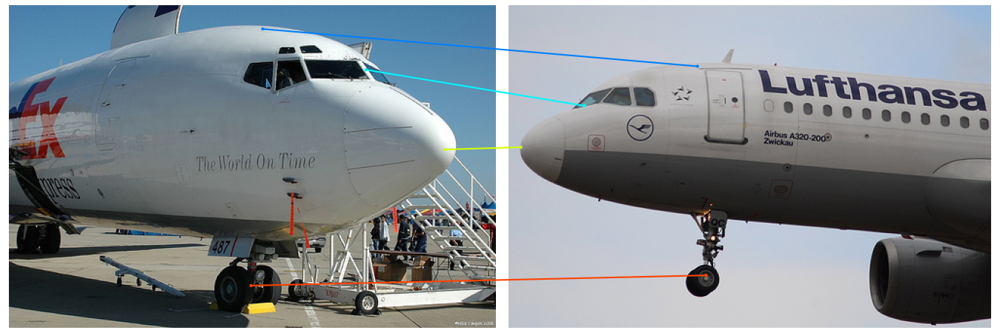

In [36]:
# pair_idx = np.argmin(pair_statistics_3['acc_0.1'])
# ==> still a lof of confusion with left and right...
# 426: 0.25 => fron wheel not correclty mapped
# 431: 0.33 => wrong wheel (big/small airplane)
# 569: 0.5 => confusion between main and rear wings
# 580: 0.2 => confusion with left and right => why do we still have these??
# 583: 0.7 => airplane very small => maybe padding improves it
# 651: 0.0 => wheel and airplane nose close together
# 27: 0.0 => confusion with left and right wind turbine (wind turbine is in shadow)
# 366: 0.25 => confusion left right wind turbine
# 664: 0.25 => front and left wheel are aligned, wheels of airplane close at normal wing location
pair_idx = 676
print(pair_statistics_3['acc_0.1'][pair_idx])
imgs_pair, kps_pair, sims_pair = spair_utils.visualize_prediction(
    img1_file=eval_files[pair_idx*2],
    img2_file=eval_files[pair_idx*2+1],
    sim_fun=sim_fun_3,
    spair_data_folder=spair_data_folder,
    embds_loader=get_geo_embd,
    # embds_folder=embds_folder,
    img_size=img_size,
    embd_size=embd_size,
    pad=True,
)

In [31]:
kps_pair_indices = kps_pair[-1]
for i, kpt_idx in enumerate(kps_pair_indices):
    print(i, kpt_idx, spair_utils.AEROPLANE_KPT_INDEX_TO_DESC[kpt_idx])

0 2 forehead
1 3 landing_gear_front


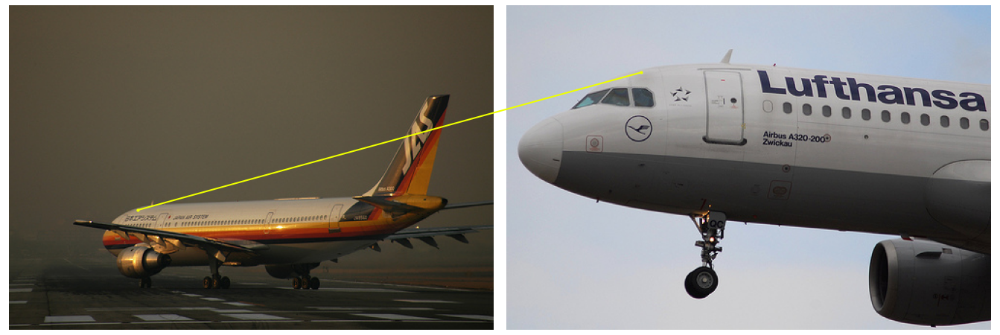

In [32]:
kpt_i = 0
kpt_idx = kps_pair_indices[kpt_i]
# print(kpt_idx, aeroplane_kpt_idx_to_desc[kpt_idx])
viz2d.plot_images([np.array(imgs_pair[0]), np.array(imgs_pair[1])])
viz2d.plot_matches(kps_pair[0][kpt_i:kpt_i+1], kps_pair[1][kpt_i:kpt_i+1])

In [306]:
# kpt_i = 5
# img1_kp1 = kps_pair[0][kpt_i]
# img1_kp2 = kps_pair[0][1]

# img2_kp2 = kps_pair[1][1]
img1 = np.array(imgs_pair[0])
img2 = np.array(imgs_pair[1])

img1_embd = get_geo_embd(eval_files[pair_idx*2], flip=False)
img2_embd = get_geo_embd(eval_files[pair_idx*2+1], flip=False)
# img1_embd = spair_utils.load_img_embd(eval_files[pair_idx*2], embds_folder, pad=PAD, angle_deg=0, flip=0)
# img1_embd = spair_utils.load_img_embd(eval_files[pair_idx*2+1], embds_folder, pad=False, angle_deg=0, flip=0)
# img2_embd = spair_utils.load_img_embd(eval_files[pair_idx*2+1], embds_folder, pad=PAD, angle_deg=0, flip=0)

In [307]:
kpt_i = 5
img1_kp1 = kps_pair[0][kpt_i]
img2_kp1 = kps_pair[1][kpt_i]
img2_kp1_pred = kps_pair[2][kpt_i]
img1_kp1_resized = np.array(spair_utils.transform_image_coords(
    img1_kp1[0], img1_kp1[1], img1.shape[1], img1.shape[0], img_size, pad=PAD
))
# img1_kp1_resized = np.array(spair_utils.transform_image_coords(
#     img1_kp2[0], img1_kp2[1], img1.shape[1], img1.shape[0], img_size, pad=PAD
# ))
# img1_kp1_resized = np.array(spair_utils.transform_image_coords(
#     img2_kp1[0], img2_kp1[1], img2.shape[1], img2.shape[0], img_size, pad=False
# ))
img1_kp1_embd, _, _ = ft_align_utils.get_img_embd_at_xy_orig(img1_kp1_resized[0], img1_kp1_resized[1], img1_embd[0], img_size, embd_size, angle_deg=0, flip=0)
kpt_index_tensor = kps_pair_indices[kpt_i]
kpt_index_pred, all_kpt_attn, sample_selection, best_sample_kpt_attn = find_kpt_index(img1_kp1_embd, aeroplane_train_img_embds_hat, aeroplane_train_img_kpt_embd_coords, True)
print(img1_kp1_resized, kpt_index_tensor, kpt_index_pred.item(), aeroplane_kpt_idx_to_desc[kpt_index_tensor])

[635 716] 5 5 landing_gear_left


In [273]:
torch.sum(all_kpt_attn[sample_selection], dim=0)

tensor([0.0115, 0.0096, 0.0113, 0.0170, 0.0204, 0.0205, 0.0111, 0.0111, 0.0085,
        0.0085, 0.0090, 0.0091, 0.0049, 0.0049, 0.0047, 0.0047, 0.0077, 0.0077,
        0.0055, 0.0055, 0.0040, 0.0039, 0.0080, 0.0101, 0.0086, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000])

In [242]:
best_sample_kpt_attn

tensor([0.0003, 0.0003, 0.0003, 0.0003, 0.0004, 0.0004, 0.0005, 0.0005, 0.0003,
        0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003,
        0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0003, 0.0000, 0.0000,
        0.0000, 0.0000, 0.0000])

In [308]:
# TODO plot all attentions as computed in find_kpt_index
attn = compute_attn(img1_kp1_embd, aeroplane_train_img_embds_hat[sample_selection])  # (n_samples, h, w)

In [275]:
importlib.reload(spair_utils)

<module 'experiments.ft_align.spair_utils' from '/home/user/Documents/projects/diffusion-features/experiments/ft_align/spair_utils.py'>

In [309]:
train_imgs = []
for flip in [False, True]:
    for img_file in aeroplane_train_files_unique:
        train_imgs.append(np.array(spair_utils.load_img(img_file, 48, pad=True, flip=flip)))
train_imgs = spair_utils.assemble_all_images(np.stack(train_imgs)[sample_selection])

In [310]:
def concat_sims(sims: torch.Tensor, per_img_size = 48, rgb=False):
    n_imgs = sims.shape[0]
    out_img_size = int(np.ceil(n_imgs**0.5)) * per_img_size
    if rgb:
        out_img = np.zeros((out_img_size, out_img_size, 3), dtype=np.uint8)
    else:
        out_img = np.zeros((out_img_size, out_img_size), dtype=float)
    for i in range(out_img_size // per_img_size):
        for j in range(out_img_size // per_img_size):
            file_idx = i*(out_img_size // per_img_size)+j
            if file_idx >= n_imgs:
                break
            out_img[i*per_img_size:(i+1)*per_img_size, j*per_img_size:(j+1)*per_img_size] = F.interpolate(sims[file_idx, :, :][None, None, :, :], (per_img_size, per_img_size))[0,0].cpu().numpy()
    return out_img

In [311]:
out_img_q = concat_sims(attn)

In [328]:
# Create a figure
fig = go.Figure()
fig.add_trace(go.Heatmap(z=out_img_q, opacity=0.6))
fig.add_trace(go.Image(z=train_imgs))
fig.update_layout(height=1000, width=1000)
fig.show()

# Learn Reweight function

In [ ]:
# TODO inspect which features are contrastive between wheels
# => reweight attentions
# => simple optimization process
# => ignore softmax
sum([q_j * xi_j]_{ij} * a) - 
# => optimize with torch gradient descent
# => sequentially find correct left/right/rear/front

In [ ]:
# construct embeddings of correct kpt => X1 (n1,c)
# construct embeddings of incorrect (but similat) kpt => X2 (n2,c)
# normalize a
# X1 @ a @ X2.T => attn_incorrect
# X1 @ a @ X1.T => attn_correct
# loss = sum(attn_incorrect) - sum(attn_correct)

In [ ]:
wheel_kpt_indices = [3,4,5] # front, right, left


In [ ]:
attn = compute_attn(query_embd, train_embds)  # (n_samples, h, w)

    # extract attns at keypoint coords
    n_kpts, n_samples = 30, len(kpt_embd_coords)
    all_kpt_attn = torch.zeros((n_samples, n_kpts))
    for i in range(n_samples):
        if kpt_embd_coords[0].size(0) > 0: 
            x_coords = kpt_embd_coords[i][:,0]
            y_coords = kpt_embd_coords[i][:,1]
            kpt_indices = kpt_embd_coords[i][:,2]
            kpt_attns = attn[i,y_coords,x_coords]
            all_kpt_attn[i,kpt_indices] = kpt_attns.cpu()
    best_sample_kpt_attn = torch.max(all_kpt_attn, dim=0).values
    kpt_index_tensor = torch.argmax(best_sample_kpt_attn)
    kpt_index = kpt_index_tensor.item()

    
    # if kpt_index has left/right issue, 
    # only consider images where both instances are present
    sample_selection = []
    if enable_left_right_check and kpt_index >= 4 and kpt_index <= 21:
        kpt_index_1 = kpt_index - (kpt_index % 2)
        kpt_index_2 = kpt_index_1 + 1
        for i in range(n_samples):
            if kpt_embd_coords[0].size(0) > 0:
                kpt_indices = kpt_embd_coords[i][:,2].tolist()
                if kpt_index_1 in kpt_indices and kpt_index_2 in kpt_indices:
                    sample_selection.append(i)

        # for each sample, find kpt index with maximum likelihood
        
        # best_kpts_per_sample = torch.argmax(all_kpt_attn[sample_selection], dim=1)
        # TODO only use top20 best guesses
        
        # NOTE this works because each image is flipped => distribution is fair
        # count occurences
        # kpt_max_count = torch.zeros((n_kpts,))
        # for best_kpt in best_kpts_per_sample.tolist():
        #     if best_kpt == kpt_index_1 or best_kpt == kpt_index_2:
        #         kpt_max_count[best_kpt] += 1
        # # print(kpt_max_count[kpt_index_1], kpt_max_count[kpt_index_2])
        # kpt_index_tensor = torch.argmax(kpt_max_count)

        best_sample_kpt_attn = torch.max(all_kpt_attn[sample_selection], dim=0).values
        kpt_index_tensor = torch.argmax(best_sample_kpt_attn)

In [166]:
out_img_q

array([[0.00027679, 0.00027471, 0.00026812, ..., 0.0002792 , 0.00029596,
        0.00029659],
       [0.00027387, 0.0002734 , 0.00027119, ..., 0.000288  , 0.00029645,
        0.00029026],
       [0.00026385, 0.00026643, 0.00024721, ..., 0.00029253, 0.00029781,
        0.00028662],
       ...,
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ],
       [0.        , 0.        , 0.        , ..., 0.        , 0.        ,
        0.        ]])

In [167]:
#convex combination of the arrays representing the two images
# https://community.plotly.com/t/how-to-overlay-two-images-with-opacity/75916/9
alpha1=0.1
# alpha2=0.9
blendarray = train_imgs * (out_img_q[:,:,None] / (np.max(out_img_q) - np.min(out_img_q)))   # (alpha1 * train_imgs + (1-alpha1)* out_img_q[:,:,None])
px.imshow(blendarray)

In [115]:
img1_kp1_embd_hat = F.normalize(img1_kp1_embd)

In [ ]:
n, c, h, w = aeroplane_train_img_embds_hat.shape
attn = aeroplane_train_img_embds_hat.view(n, c, h*w) * img1_kp1_embd_hat[:,:,None]
attn = torch.sum(attn , dim=1)
# attn = F.softmax(attn, dim=-1).view(n, h, w)
attn = attn.view(n, h, w)

In [ ]:
n, c, h, w = aeroplane_eval_img_embds_hat.shape
attn_eval = aeroplane_eval_img_embds_hat.view(n, c, h*w) * img1_kp1_embd_hat[:,:,None]
attn_eval = torch.sum(attn_eval , dim=1)
# attn_eval = F.softmax(attn_eval, dim=-1)
attn_eval = attn_eval.view(n, h, w)

In [ ]:
out_img = concat_sims(attn)
out_img_eval = concat_sims(attn_eval)

In [ ]:
px.imshow(out_img_eval)

In [ ]:
px.imshow(out_img)

tensor(6)

In [ ]:
find_kpt_index(img1_kp1_embd, aeroplane_train_img_embds_hat, aeroplane_train_img_kpt_embd_coords)
sim = compute_max_attn(
    kpt_embds=kpt_idx_to_kpt_embds[3], 
    test_embd=img2_embd
)
px.imshow(sim)

# Encode Images

## SD Encoder

In [9]:
dift = SDFeaturizer()

/home/user/anaconda3/envs/kf/lib/python3.9/site-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


stabilityai/stable-diffusion-2-1


In [10]:
def encode_img_sd(img_filepath, prompt: str, img_size = 768, ensemble_size = 8, angle_deg=0, flip=0, pad=False):  # edge=False, 
    img = Image.open(img_filepath)
    if pad:
        img = utils_correspondence.resize(
            img, 
            target_res=img_size, 
            resize=True, 
            to_pil=True, 
            edge=False
        )
    else:
        # img = utils_correspondence.resize(img, img_size, resize=True, to_pil=True, edge=edge)
        img = img.resize((img_size, img_size))
    if flip == 1:
        img = img.transpose(Image.FLIP_LEFT_RIGHT)
    # TODO check whether rotatation here works with other functions when padded
    img = img.rotate(angle_deg)
    # TODO  do we need to resize again?
    img = img.resize((img_size, img_size))
    # normalize image to [-1, 1]
    img_tensor = (PILToTensor()(img) / 255.0 - 0.5) * 2
    img_tensor = torch.stack([img_tensor])
    # print(img_tensors.shape)
    # encode
    with torch.no_grad():
        img_embd = dift.forward(img_tensor, prompt=prompt, ensemble_size=ensemble_size)
    return img, img_embd

In [10]:
t1, t2 = encode_img_sd(
    aeroplane_train_files_unique[0],
    prompt="a photo of an airplane",
    img_size=960, 
    ensemble_size=8, 
    angle_deg=0,
    flip=0, 
    pad=True
)

In [11]:
t2.shape

torch.Size([1, 1280, 60, 60])

### Encode images

In [18]:
cat_idx = 0 # aeroplane
category_name = "aeroplane"
prompt = f'a photo of an airplane'
img_size = 960
pad = True
sd_embds_folder = f'/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures60x60'
angle_degrees = [0]  # np.arange(0, 360, 5)
flips = [0,1]
for img_filename in tqdm(aeroplane_train_files_unique):
    img_filename_noext = os.path.basename(img_filename).split(".")[0]
    for flip in flips:
        for angle_deg in angle_degrees:
            pad_int = 1 if pad else 0
            pt_filepath = f'{sd_embds_folder}/{category_name}/{img_filename_noext}_pad={pad_int}_rot={int(angle_deg)}_flip={flip}.pt'
            img, img_embd = encode_img_sd(img_filename, prompt, img_size=img_size, angle_deg=angle_deg, flip=flip, pad=pad)
            torch.save(img_embd.cpu(), pt_filepath)
            del img_embd
            # img.save(f'/media/user/EXTREMESSD/datasets/SPair-71k/imgs/{category_name}/{img_filename_noext}_rot={int(angle_deg)}_flip={flip}.jpg')

100%|██████████| 55/55 [05:16<00:00,  5.75s/it]


## SegAny Encoder

In [128]:
seg_any_ckpt_path = "/home/user/Documents/model_ckpts/sam_vit_h_4b8939.pth"

from segment_anything import SamPredictor, sam_model_registry
sam = sam_model_registry["vit_h"](checkpoint=seg_any_ckpt_path)
predictor = SamPredictor(sam)

In [136]:
predictor.model.to("cuda")

Sam(
  (image_encoder): ImageEncoderViT(
    (patch_embed): PatchEmbed(
      (proj): Conv2d(3, 1280, kernel_size=(16, 16), stride=(16, 16))
    )
    (blocks): ModuleList(
      (0-31): 32 x Block(
        (norm1): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (attn): Attention(
          (qkv): Linear(in_features=1280, out_features=3840, bias=True)
          (proj): Linear(in_features=1280, out_features=1280, bias=True)
        )
        (norm2): LayerNorm((1280,), eps=1e-06, elementwise_affine=True)
        (mlp): MLPBlock(
          (lin1): Linear(in_features=1280, out_features=5120, bias=True)
          (lin2): Linear(in_features=5120, out_features=1280, bias=True)
          (act): GELU(approximate='none')
        )
      )
    )
    (neck): Sequential(
      (0): Conv2d(1280, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (1): LayerNorm2d()
      (2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (3): LayerNorm2d

In [139]:
flip = 0
angle_deg = 0
img = Image.open(train_files[1])
# img = utils_correspondence.resize(img, img_size, resize=True, to_pil=True, edge=edge)
img = img.resize((img_size, img_size))
if flip == 1:
    img = img.transpose(Image.FLIP_LEFT_RIGHT)
img = img.rotate(angle_deg)
img = img.resize((img_size, img_size))

In [140]:
predictor.set_image(np.array(img))

In [141]:
img_embd = predictor.get_image_embedding()

In [145]:
img_embd.device

device(type='cuda', index=0)

In [143]:
from einops import rearrange
img_embd_tmp = rearrange(img_embd, "b c h w -> b h w c")
# 2) plot pca of selected features
colored_image = pca_colormap.apply_pca_colormap(img_embd_tmp[:,:,:,:].float().cpu())
px.imshow(colored_image[0])

In [148]:
def encode_img_segany(img_filepath, img_size = 768, angle_deg=0, flip=0):  # edge=False, 
    img = Image.open(img_filepath)
    # img = utils_correspondence.resize(img, img_size, resize=True, to_pil=True, edge=edge)
    img = img.resize((img_size, img_size))
    if flip == 1:
        img = img.transpose(Image.FLIP_LEFT_RIGHT)
    img = img.rotate(angle_deg)
    img = img.resize((img_size, img_size))
    predictor.set_image(np.array(img))
    img_embd = predictor.get_image_embedding()  # shape (1, 256, 64, 64)
    return img, img_embd

In [147]:
embds_folder

'/media/user/EXTREMESSD/datasets/SPair-71k/DiffusionFeatures'

In [149]:
segany_embds_folder = '/media/user/EXTREMESSD/datasets/SPair-71k/SegAnyFeatures'

In [152]:
# encode eval files
cat_idx = 0
angle_deg = 0
flip = 0
category_name = "aeroplane"
for img_filename in tqdm(list(set(eval_files))):
    img_filename_noext = os.path.basename(img_filename).split(".")[0]
    pt_filepath = f'{segany_embds_folder}/{category_name}/{img_filename_noext}_rot={int(angle_deg)}_flip={flip}.pt'
    img, img_embd = encode_img_segany(img_filename, angle_deg=0, flip=flip)
    torch.save(img_embd.cpu(), pt_filepath)

100%|██████████| 27/27 [00:12<00:00,  2.24it/s]


In [151]:
# encode train files
cat_idx = 0 # aeroplane
category_name = "aeroplane"
angle_degrees = [0]  # np.arange(0, 360, 5)
for img_filename in tqdm(aeroplane_train_files_unique):
    img_filename_noext = os.path.basename(img_filename).split(".")[0]
    for angle_deg in angle_degrees:
        pt_filepath = f'{segany_embds_folder}/{category_name}/{img_filename_noext}_rot={int(angle_deg)}_flip={flip}.pt'
        img, img_embd = encode_img_segany(img_filename, angle_deg=angle_deg, flip=0)
        torch.save(img_embd.cpu(), pt_filepath)

100%|██████████| 55/55 [00:24<00:00,  2.24it/s]


# Reference

In [ ]:
# reference

def find_kpt_index(query_embd: torch.Tensor):
    """
    Args:
        query_embd: (1, C)
    """
    n_kpts, n_samples, embd_dim = stacked_kpt_embds.size()
    # dists2 = torch.sum((query_embd - stacked_kpt_embds.view(-1, embd_dim))**2, dim=-1).view(n_kpts, n_samples)
    # similarities = -torch.min(dists2, dim=-1).values

    # ft_attn = query_embd * stacked_kpt_embds.view(-1, embd_dim)
    # ...

    similarities = F.cosine_similarity(query_embd, stacked_kpt_embds.view(-1, embd_dim), dim=1)
    similarities = similarities.view(30, n_samples)
    similarities = torch.mean(similarities, dim=-1)
    kpt_idx = torch.argmax(similarities)
    return kpt_idx.item()

def sim_fun_2(query_embd, trg_img_embd):
    """
    Args:
        query_embd: (1, C)
        trg_img_embd: (1, C, embd_size, embd_size)
    """
    kpt_index = find_kpt_index(query_embd.to("cuda"))
    kpt_embds = stacked_kpt_embds[kpt_index] # (n_imgs, C)
    trg_img_embd_repeat = trg_img_embd[0].to("cuda").repeat(kpt_embds.shape[0], 1, 1, 1)  # (n_imgs, C, embd_size, embd_size)
    

    # 1) cosine simlilarity    
    # similarities = F.cosine_similarity(kpt_embds[:,:,None, None], trg_img_embd_repeat, dim=1)
    
    # 2) squared dist between features
    # similarities = -torch.sum((kpt_embds[:,:,None, None] - trg_img_embd_repeat)**2, dim=1)

    # 3) multiply with a kpt embd
    similarities = -torch.sum(((kpt_embds[:,:,None, None] - trg_img_embd_repeat) * kpt_embds[0][None,:,None,None])**2, dim=1)

    return torch.max(similarities, dim=0, keepdim=False).values.cpu()